# Import packages and data 

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import scipy.stats
import anndata
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib.axes._axes import _log as matplotlib_axes_logger
from scipy import sparse
matplotlib_axes_logger.setLevel('ERROR')

In [2]:
sc.settings.verbosity = 1  # verbosity: errors (0), warnings (1), info (2), hints (3)
# Set up the plot config for viewing the annotation clearly.
sc.settings.set_figure_params(dpi=120, dpi_save=1000)
sc.logging.print_versions()

scanpy==1.4.4 anndata==0.6.22.post1 umap==0.3.7 numpy==1.15.4 scipy==1.3.0 pandas==0.23.4 scikit-learn==0.20.2 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [3]:
adata = sc.read('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/bm_plus_19pcw_annot_20200219.h5ad')

In [4]:
adata

AnnData object with n_obs × n_vars = 107394 × 26258 
    obs: 'AnnatomicalPart', 'LouvainClustering', '__is_in_cluster__', 'batch', 'cell.labels', 'cell.labels.backlabelled.1', 'cell.labels2', 'cell.labels_sb', 'doublets', 'fetal.ids', 'gender', 'is_doublet', 'is_doublet_poptrim', 'is_doublet_wolock', 'lanes', 'leiden', 'location', 'nGene', 'nUMI', 'n_genes', 'orig.ident', 'percent.mito', 'predicted.cell.label', 'processing.type', 'sample.type', 'scrublet_cluster_score', 'scrublet_score', 'sequencing.type', 'sort.ids', 'stages', 'tissue', 'orig_cell.labels'
    var: 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene_ids-1', 'feature_types-1', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell.labels_colors', 'dendrogram_leiden', 'lanes_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'rank_genes_groups_filtered', 'sequencing.type_colors'
    obsm: 'X_orig_pca', 'X_pca', 'X_umap'
    

# Subset to resident clusters

In [5]:
from scipy import sparse
array_vals = adata.X
adata.X = sparse.csr_matrix(adata.X)
adata.raw = adata
adata.X = array_vals

In [6]:
adata = adata[adata.obs['cell.labels'].isin(['myelocyte/myeloid', 'monocyte/myeloid'])].copy()

In [7]:
adata

AnnData object with n_obs × n_vars = 34467 × 26258 
    obs: 'AnnatomicalPart', 'LouvainClustering', '__is_in_cluster__', 'batch', 'cell.labels', 'cell.labels.backlabelled.1', 'cell.labels2', 'cell.labels_sb', 'doublets', 'fetal.ids', 'gender', 'is_doublet', 'is_doublet_poptrim', 'is_doublet_wolock', 'lanes', 'leiden', 'location', 'nGene', 'nUMI', 'n_genes', 'orig.ident', 'percent.mito', 'predicted.cell.label', 'processing.type', 'sample.type', 'scrublet_cluster_score', 'scrublet_score', 'sequencing.type', 'sort.ids', 'stages', 'tissue', 'orig_cell.labels'
    var: 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene_ids-1', 'feature_types-1', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell.labels_colors', 'dendrogram_leiden', 'lanes_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'rank_genes_groups_filtered', 'sequencing.type_colors'
    obsm: 'X_orig_pca', 'X_pca', 'X_umap'
    v

# Reset expression values 

In [8]:
all_data = sc.read('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/bm_plus-19pcw_combined_20200218.h5ad')

In [9]:
all_data

AnnData object with n_obs × n_vars = 107442 × 33711 
    obs: 'AnnatomicalPart', 'LouvainClustering', '__is_in_cluster__', 'batch', 'cell.labels', 'cell.labels.backlabelled.1', 'cell.labels2', 'cell.labels_sb', 'doublets', 'fetal.ids', 'gender', 'is_doublet', 'is_doublet_poptrim', 'is_doublet_wolock', 'lanes', 'leiden', 'location', 'nGene', 'nUMI', 'n_genes', 'orig.ident', 'percent.mito', 'predicted.cell.label', 'processing.type', 'sample.type', 'scrublet_cluster_score', 'scrublet_score', 'sequencing.type', 'sort.ids', 'stages', 'tissue'
    var: 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene_ids-1', 'feature_types-1'

In [10]:
all_data.X = np.nan_to_num(all_data.X, copy=False)

In [11]:
all_data.raw = all_data

In [12]:
# delete the cell.labels slot in the large dataset 
all_data.obs["cell.labels2"] = all_data.obs["cell.labels"]
del all_data.obs["cell.labels"]

In [13]:
# add the cell labels onto the new dataset with clean expression values
all_data.obs["cell.labels"] = adata.obs["cell.labels"]

In [14]:
# remove cells that do not have an annotation 
temp_adata = all_data[~all_data.obs['cell.labels'].isnull()].copy()

In [15]:
temp_adata.shape
adata = temp_adata
adata

AnnData object with n_obs × n_vars = 34467 × 33711 
    obs: 'AnnatomicalPart', 'LouvainClustering', '__is_in_cluster__', 'batch', 'cell.labels.backlabelled.1', 'cell.labels2', 'cell.labels_sb', 'doublets', 'fetal.ids', 'gender', 'is_doublet', 'is_doublet_poptrim', 'is_doublet_wolock', 'lanes', 'leiden', 'location', 'nGene', 'nUMI', 'n_genes', 'orig.ident', 'percent.mito', 'predicted.cell.label', 'processing.type', 'sample.type', 'scrublet_cluster_score', 'scrublet_score', 'sequencing.type', 'sort.ids', 'stages', 'tissue', 'cell.labels'
    var: 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene_ids-1', 'feature_types-1'

In [16]:
cell_numbers = adata.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
monocyte/myeloid     29659
myelocyte/myeloid     4808
dtype: int64

In [17]:
adata.X

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [18]:
adata.raw.X

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

# Pre-process and add dr

In [19]:
adata

AnnData object with n_obs × n_vars = 34467 × 33711 
    obs: 'AnnatomicalPart', 'LouvainClustering', '__is_in_cluster__', 'batch', 'cell.labels.backlabelled.1', 'cell.labels2', 'cell.labels_sb', 'doublets', 'fetal.ids', 'gender', 'is_doublet', 'is_doublet_poptrim', 'is_doublet_wolock', 'lanes', 'leiden', 'location', 'nGene', 'nUMI', 'n_genes', 'orig.ident', 'percent.mito', 'predicted.cell.label', 'processing.type', 'sample.type', 'scrublet_cluster_score', 'scrublet_score', 'sequencing.type', 'sort.ids', 'stages', 'tissue', 'cell.labels'
    var: 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene_ids-1', 'feature_types-1'

In [20]:
# normalise count data 
sc.pp.normalize_total(adata)

In [21]:
# log the count data 
sc.pp.log1p(adata)

In [22]:
# find variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) 

In [23]:
# scale the data 
sc.pp.scale(adata, max_value=10)

In [24]:
# run pca
sc.tl.pca(adata, n_comps=50)

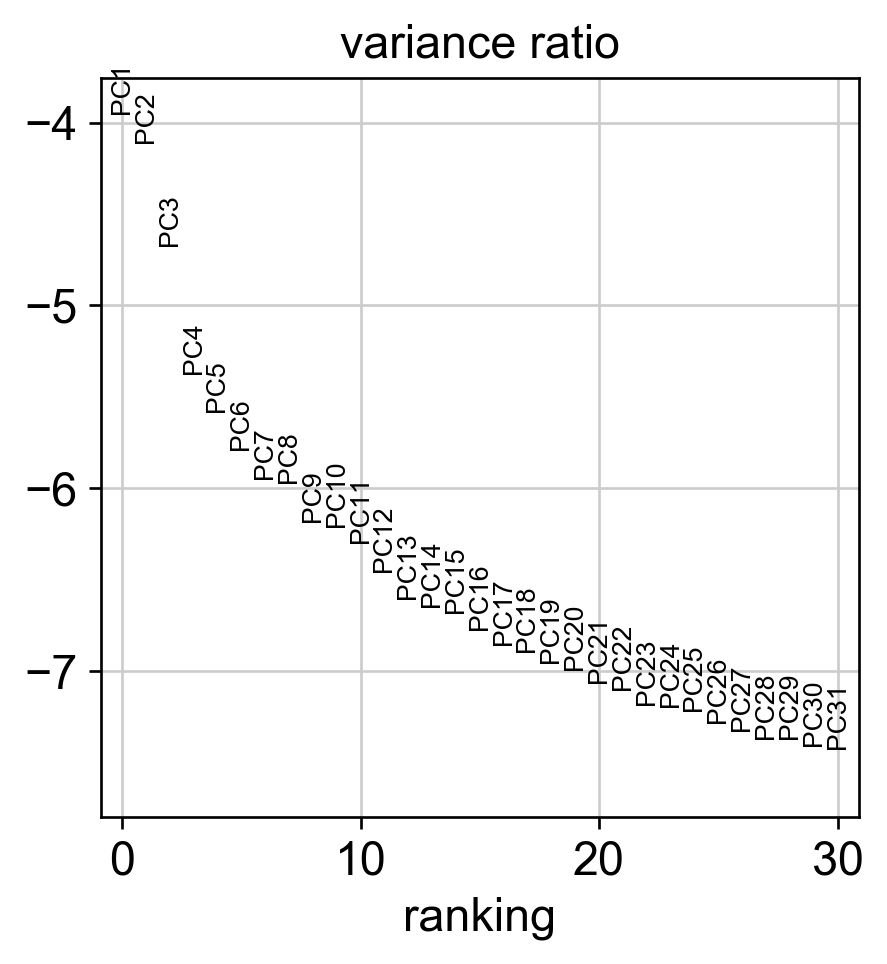

In [25]:
# have a look at pc's in order to choose number of pcs that will be used downstream 
sc.pl.pca_variance_ratio(adata, log=True)

In [26]:
# run snn neighbourhood graph
sc.pp.neighbors(adata, n_neighbors=40, n_pcs=10) 

In [27]:
# run umap
sc.tl.umap(adata) 

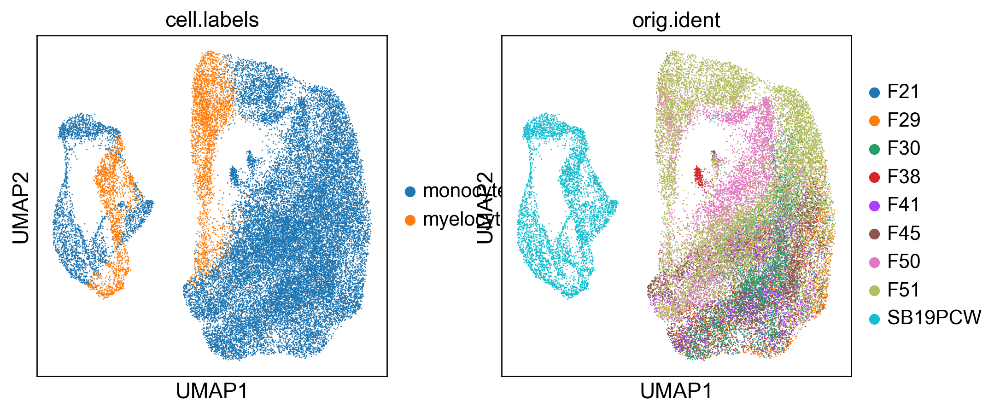

In [28]:
sc.pl.umap(adata, color=['cell.labels', 'orig.ident'], size=3) 

In [29]:
# run fdg 
# As an input, FDG requires PCA coordinates and a snn graph. must redo snn graph if re-running fdg on subsets 
sc.tl.draw_graph(adata, init_pos='X_pca', layout='fa')

In [30]:
# run diffmap
sc.tl.diffmap(adata, n_comps=10)

In [31]:
## PCA
sc.pl.pca(adata, color='cell.labels', save='_myeloid_pre-harmony_cell_labels_legoff.pdf', show=False)

## UMAP
sc.pl.umap(adata, color='cell.labels', save='_myeloid_pre-harmony_cell_labels_legoff.pdf', show=False, size=3) 
sc.pl.umap(adata, color='cell.labels', save='_myeloid_pre-harmony_cell_labels_legon.pdf', show=False, size=3, legend_loc="on data", legend_fontsize=6)

## FDG
sc.pl.draw_graph(adata, color='cell.labels', layout='fa', show=False, save='_myeloid_pre-harmony_cell_labels_legoff.pdf')
sc.pl.draw_graph(adata, color='cell.labels', legend_loc='on data', show=False, save='_myeloid_pre-harmony_cell_labels_legon.pdf', legend_fontsize=6)

## DIFFUSION MAP
sc.pl.scatter(adata, basis='diffmap', show=False, save='_myeloid_pre-harmony_cell_labels_legoff.pdf', color='cell.labels') 

In [32]:
# plot pre-harmony umaps coloured by different variables

## UMAP by cell labels
sc.pl.umap(adata, color='cell.labels', save='_myeloid_pre-harmony_cell_labels_legoff.pdf', size=3, show=False) 
sc.pl.umap(adata, color='cell.labels', save='_myeloid_pre-harmony_cell_labels_legon.pdf', size=3, show=False, legend_loc="on data", legend_fontsize=6)

## UMAP by sequencing type 
sc.pl.umap(adata, color='sequencing.type', save='_myeloid_pre-harmony_seq_type_legoff.pdf', size=3, show=False) 

## UMAP by sample 
sc.pl.umap(adata, color='orig.ident', save='_myeloid_pre-harmony_sample_type_legoff.pdf', size=3, show=False) 

# Run harmony batch correction

In [33]:
#harmony prep - save pca and batch (sample) metadata columns 
pca = adata.obsm['X_pca']
batch = adata.obs['orig.ident']

In [34]:
# load up harmony in rpy2
%load_ext rpy2.ipython

In [35]:
%%R -i pca -i batch -o hem

library(harmony)
library(magrittr)

hem = HarmonyMatrix(pca, batch, theta=3, verbose=TRUE, do_pca=FALSE)
hem = data.frame(hem)

R[write to console]: Loading required package: Rcpp

R[write to console]: Harmony 1/10

R[write to console]: 0%   10   20   30   40   50   60   70   80   90   100%

R[write to console]: [----|----|----|----|----|----|----|----|----|----|

R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[write to console]: *
R[

In [36]:
# save old pca values or orig.pca and save batch corrected pca results in anndata object as x_pca
adata.obsm['X_orig_pca'] = adata.obsm['X_pca']
adata.obsm['X_pca'] = hem.values

# Add dimensional reduction post-harmony

In [37]:
# run snn neighbourhood graph
sc.pp.neighbors(adata, n_neighbors=40, n_pcs=10) 

In [38]:
# run umap
sc.tl.umap(adata) 

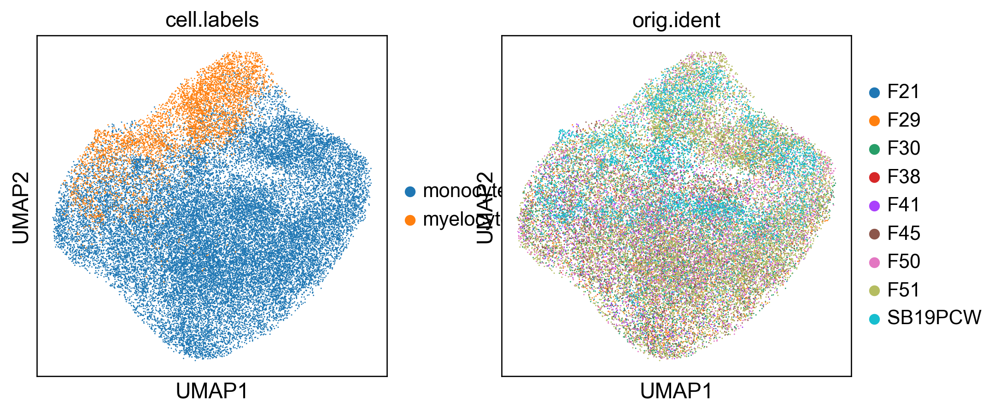

In [39]:
#plot umap post harmony
sc.pl.umap(adata, color=['cell.labels', 'orig.ident'], size=3)

In [40]:
# run fdg 
sc.tl.draw_graph(adata, init_pos='X_pca', layout='fa')

In [41]:
# run diffmap
sc.tl.diffmap(adata, n_comps=10)

In [42]:
## PCA
sc.pl.pca(adata, color='cell.labels', save='_myeloid_post-harmony_cell_labels_legoff.pdf', show=False)

## UMAP
sc.pl.umap(adata, color='cell.labels', save='_myeloid_post-harmony_cell_labels_legoff.pdf', show=False, size=3) 
sc.pl.umap(adata, color='cell.labels', save='_myeloid_post-harmony_cell_labels_legon.pdf', show=False, size=3, legend_loc="on data", legend_fontsize=6)

## FDG
sc.pl.draw_graph(adata, color='cell.labels', layout='fa', show=False, save='_myeloid_post-harmony_cell_labels_legoff.pdf')
sc.pl.draw_graph(adata, color='cell.labels', legend_loc='on data', show=False, save='_myeloid_post-harmony_cell_labels_legon.pdf', legend_fontsize=6)

## DIFFUSION MAP
sc.pl.scatter(adata, basis='diffmap', show=False, save='_myeloid_post-harmony_cell_labels_legoff.pdf', color='cell.labels') 

In [43]:
# plot post-harmony umaps coloured by different variables

## UMAP by cell labels
sc.pl.umap(adata, color='cell.labels', save='_myeloid_post-harmony_cell_labels_legoff.pdf', size=3, show=False) 
sc.pl.umap(adata, color='cell.labels', save='_myeloid_post-harmony_cell_labels_legon.pdf', show=False, size=3, legend_loc="on data", legend_fontsize=6)

## UMAP by sequencing type 
sc.pl.umap(adata, color='sequencing.type', save='_myeloid_post-harmony_seq_type_legoff.pdf', show=False, size=3) 

## UMAP by sample 
sc.pl.umap(adata, color='orig.ident', save='_myeloid_post-harmony_sample_type_legoff.pdf', show=False, size=3) 

# Perform leiden clustering

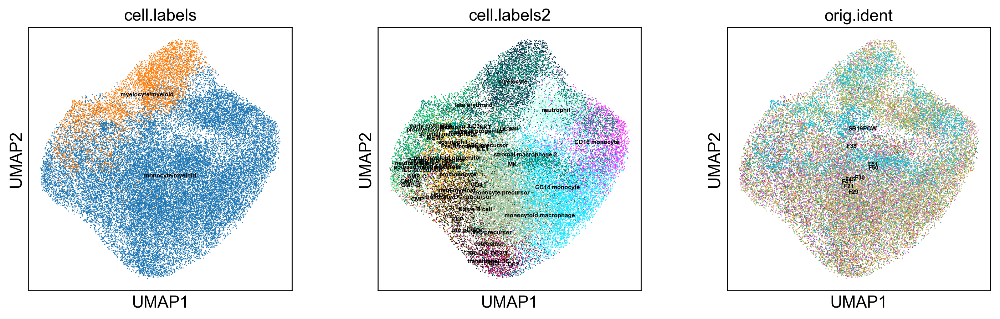

In [44]:
sc.pl.umap(adata, color=['cell.labels', 'cell.labels2', 'orig.ident'], legend_loc="on data", size=3, legend_fontsize=5)

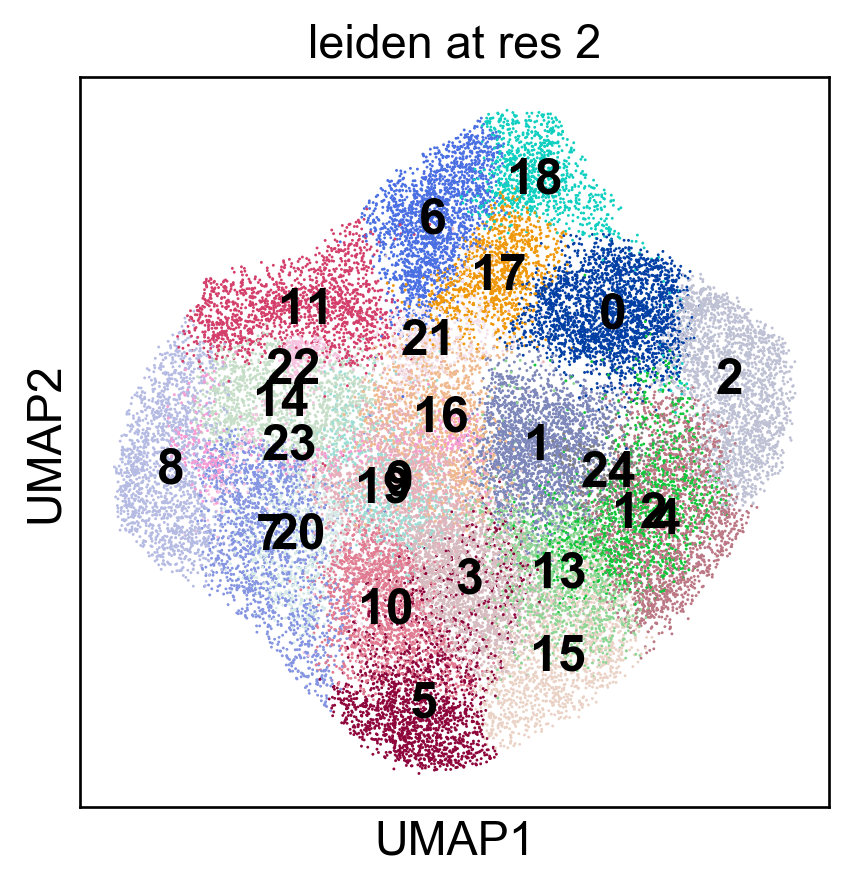

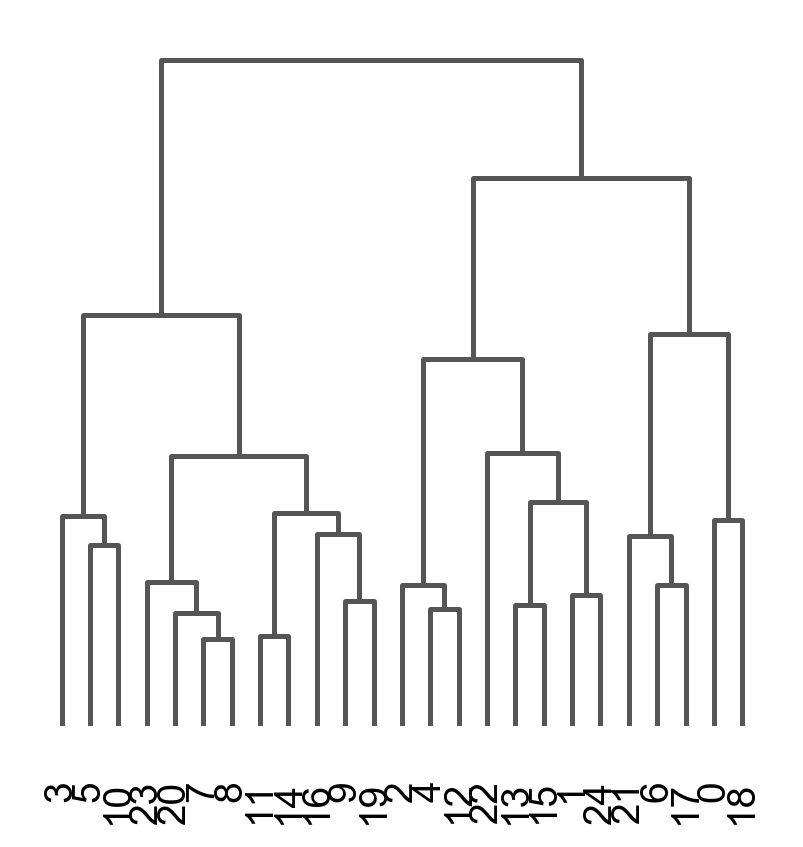

25

In [45]:
sc.tl.leiden(adata, resolution=2, random_state=26, n_iterations=-1)

sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=15, title="leiden at res 2")
leiden_res_2 = len(adata.obs["leiden"].unique())

# plot a dendogram to show relationships between clusters
sc.tl.dendrogram(adata, groupby='leiden', n_pcs=20, use_rep='X_pca') 
sc.pl.dendrogram(adata, groupby='leiden', save='dendogram_for_initial_leiden_clusters.pdf')

leiden_res_2

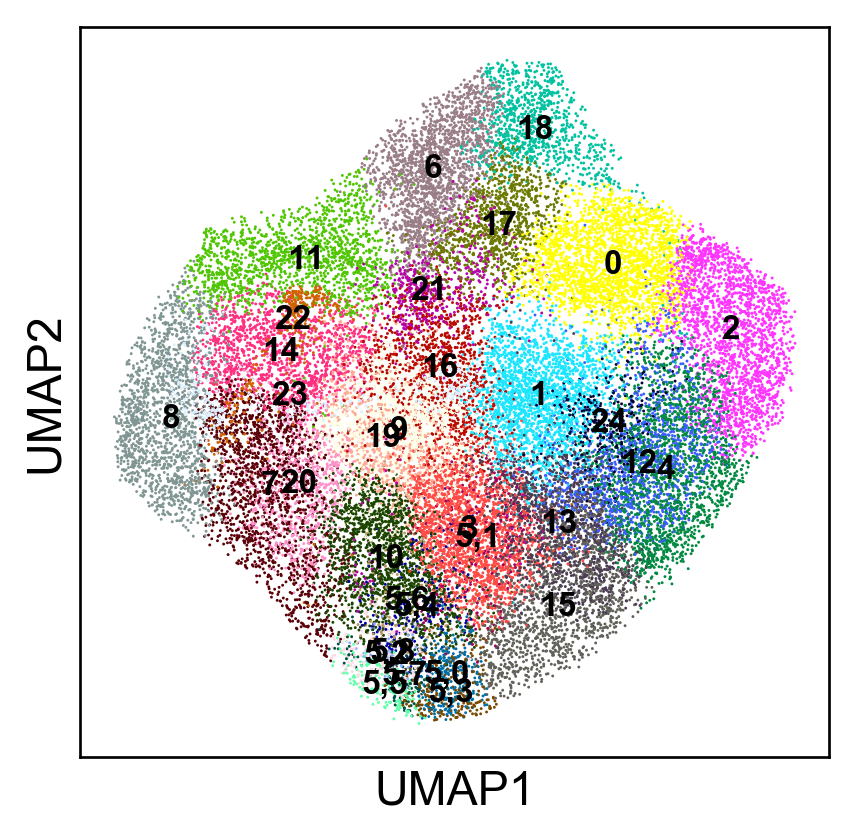

In [47]:
sc.tl.leiden(adata, resolution=1, random_state=26, n_iterations=-1, restrict_to=("leiden", ["5"]))
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=10, title="")

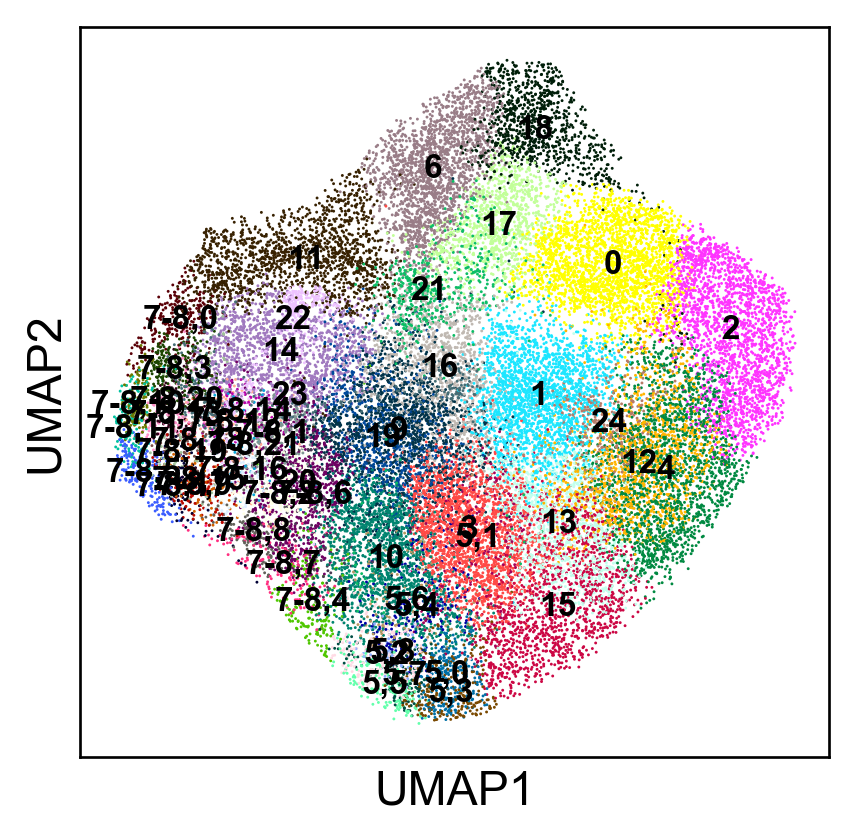

In [49]:
sc.tl.leiden(adata, resolution=2, random_state=26, n_iterations=-1, restrict_to=("leiden", ["7", "8"]))
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=10, title="")

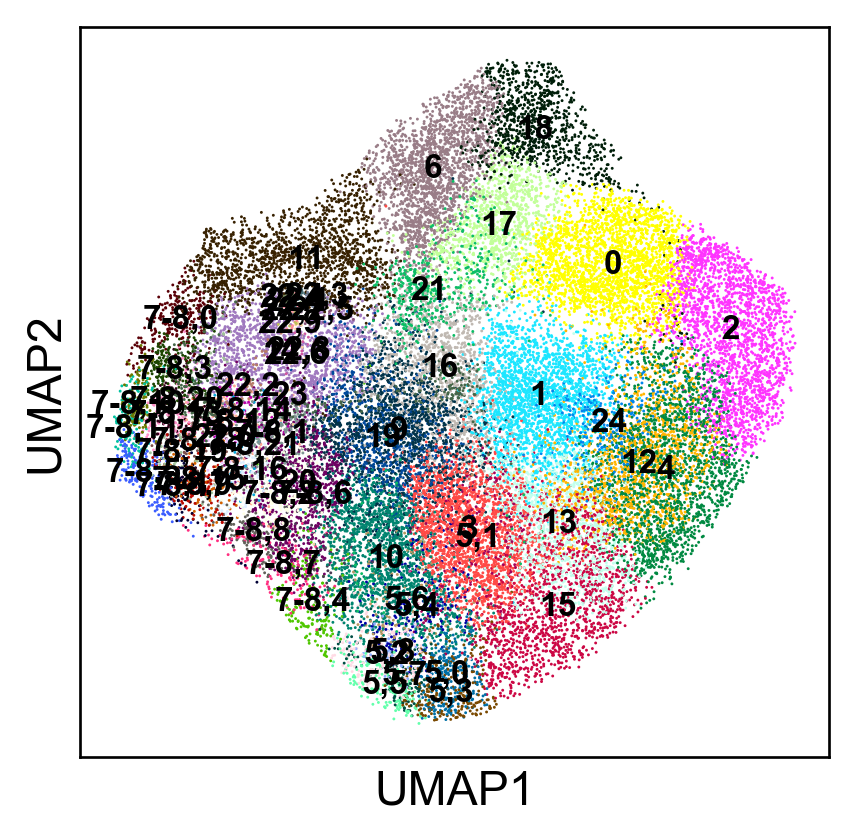

In [51]:
sc.tl.leiden(adata, resolution=1.5, random_state=26, n_iterations=-1, restrict_to=("leiden", ["22"]))
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=10, title="")

In [52]:
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
cell_numbers = adata.obs.groupby(["leiden", "cell.labels2"]).apply(len)
cell_numbers

leiden  cell.labels2           
0       CD14 monocyte               320
        CD16 monocyte               335
        DC3                           7
        basophil                      2
        mast cell                     1
        monocyte precursor           22
        monocytoid macrophage         5
        myelocyte                    40
        nan                         338
        neutrophil                 1292
        pDC                           1
        pDC precursor                 6
        stromal macrophage 2          2
1       CD14 monocyte              1426
        CD16 monocyte                74
        DC2                           1
        DC2/3                         4
        DC3                          34
        DC precursor                  3
        monocyte precursor          213
        monocytoid macrophage         7
        myelocyte                     6
        nan                         415
        neutrophil                   45
        

# Calculate differentially expressed genes

In [53]:
# scale the negative values in adata.X (which have been normalised, logged and scaled) to zero 
adata.X = np.where(adata.X < 0, 0, adata.X)

In [55]:
# run degs on normalised and logged data (saved as adata.raw), not on additionally scaled data (saved as adata.X).
# calculate degs using wilcoxon rank sum test with benjamini-hochberg correction. 
#based on ln transformed count data 
sc.tl.rank_genes_groups(adata, groupby='leiden', method='wilcoxon', use_raw=False, log_transformed=True)

In [56]:
# filter the degs for those which are expressed in at least 25% of cells in cluster. log2fc of the ln-transformed
# data will be shown.
sc.tl.filter_rank_genes_groups(adata, min_in_group_fraction=0.25, min_fold_change=0.25, use_raw=False)

In [57]:
# save df for unfiltered degs
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs_by_cluster = pd.DataFrame({group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges']})

# the degs_by_cluster df shows the log2 fold change for each gene ordered by z-score underlying the computation 
# of a p-value for each gene for each group
degs_by_cluster.to_csv("/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/figs/clustering_degs/myeloid/myeloid_degs_by_cluster_20200221.csv")
degs_by_cluster[:10]

,0_n,0_l,1_n,1_l,2_n,2_l,3_n,3_l,4_n,4_l,"5,0_n","5,0_l","5,1_n","5,1_l","5,2_n","5,2_l","5,3_n","5,3_l","5,4_n","5,4_l","5,5_n","5,5_l","5,6_n","5,6_l","5,7_n","5,7_l","5,8_n","5,8_l",6_n,6_l,"7-8,0_n","7-8,0_l","7-8,1_n","7-8,1_l","7-8,2_n","7-8,2_l","7-8,3_n","7-8,3_l","7-8,4_n","7-8,4_l","7-8,5_n","7-8,5_l","7-8,6_n","7-8,6_l","7-8,7_n","7-8,7_l","7-8,8_n","7-8,8_l","7-8,9_n","7-8,9_l","7-8,10_n","7-8,10_l","7-8,11_n","7-8,11_l","7-8,12_n","7-8,12_l","7-8,13_n","7-8,13_l","7-8,14_n","7-8,14_l","7-8,15_n","7-8,15_l","7-8,16_n","7-8,16_l","7-8,17_n","7-8,17_l","7-8,18_n","7-8,18_l","7-8,19_n","7-8,19_l","7-8,20_n","7-8,20_l","7-8,21_n","7-8,21_l",9_n,9_l,10_n,10_l,11_n,11_l,12_n,12_l,13_n,13_l,14_n,14_l,15_n,15_l,16_n,16_l,17_n,17_l,18_n,18_l,19_n,19_l,20_n,20_l,21_n,21_l,"22,0_n","22,0_l","22,1_n","22,1_l","22,2_n","22,2_l","22,3_n","22,3_l","22,4_n","22,4_l","22,5_n","22,5_l","22,6_n","22,6_l","22,7_n","22,7_l","22,8_n","22,8_l","22,9_n","22,9_l",23_n,23_l,24_n,24_l
0,S100A6,2.501269,VCAN,2.075077,NAMPT,4.172007,MKI67,2.433116,CD14,3.056164,CLEC10A,5.377014,HLA-DPA1,2.672658,HLA-DPA1,3.836462,HLA-DPA1,4.655205,HLA-DPA1,2.365966,CLEC10A,5.294030,HLA-DPA1,2.584389,HLA-DPA1,3.839931,HLA-DPA1,2.697285,RETN,4.150149,PRSS57,5.453132,PRTN3,2.703601,PRTN3,2.239018,PRTN3,5.659068,LDHB,2.753352,EGFL7,6.362328,NME1,2.727505,KCNE5,3.665957,LDHB,2.782432,PRSS57,4.535793,PRSS57,5.134428,PRSS57,5.448107,PRSS57,4.381971,PRSS57,4.684075,PRTN3,3.339771,PRSS57,4.258856,PRSS57,3.517112,EGFL7,5.959833,PRSS57,4.354239,PRSS57,4.466225,PRSS57,5.059231,PRTN3,2.799732,RP11-1143G9.4,2.088739,NUP210,1.920089,AZU1,4.360012,CD52,2.039487,VCAN,1.633680,MPO,2.385972,CD74,1.970577,LGALS1,1.711429,S100A12,2.792756,LTF,5.449370,MPO,1.250980,MPO,1.900964,MT-CYB,6.261889,GATA2,12.235979,HDC,14.961908,GATA2,14.611091,HDC,17.169781,CPA3,11.872987,CLC,8.578490,CLC,7.781456,GATA2,13.756530,HDC,13.298888,GCSAML,15.541446,RPS6,7.359112,HSPA1A,4.010753
1,IFITM2,3.287292,CST3,1.892171,VNN2,4.394805,UBE2C,2.710753,CD52,2.333398,HLA-DPA1,3.582579,HLA-DRA,1.862801,HLA-DPB1,4.209113,HLA-DPB1,4.864425,CLEC10A,3.931565,HLA-DPA1,3.623435,CD74,1.639093,HLA-DPB1,3.697190,SAMHD1,1.895801,LTF,5.816477,PRTN3,4.162935,MPO,2.018845,MPO,1.710222,CTSG,5.001772,C12orf75,3.783197,PRSS57,4.682489,RANBP1,2.252422,NREP,2.839868,PRSS57,3.186650,PRTN3,3.291397,CALR,3.767448,C1QTNF4,7.567334,LDHB,3.165413,SMIM24,6.483469,PRSS57,3.836302,PRTN3,2.850215,PRTN3,2.745721,PRSS57,4.398092,PRTN3,3.159536,PRTN3,3.995216,CTSG,3.983157,CLEC11A,2.782575,KIAA0101,2.479480,TAGLN2,1.401700,MPO,3.661750,HP,2.262846,S100A10,1.556512,AZU1,2.623847,HLA-DPA1,3.164263,TMSB10,1.730450,S100A9,1.802224,PGLYRP1,4.106804,RETN,0.191983,PRTN3,2.413625,MT-CO2,5.939676,CPA3,9.167532,CLC,11.427297,CPA3,12.339470,MALAT1,6.780986,GATA2,14.232247,HDC,15.771804,HDC,13.359697,HDC,15.038783,CPA3,10.174029,IL1RL1,15.064670,RPS8,7.382308,HSPH1,3.989767
2,TYROBP,2.520062,S100A10,1.873681,BCL2A1,3.615859,CALM3,1.671253,VCAN,2.043761,HLA-DPB1,3.713655,CLEC10A,4.042006,CLEC10A,5.418136,HLA-DRB1,3.151954,HLA-DPB1,2.370258,ENHO,8.335718,HLA-DPB1,2.413133,CLEC10A,4.836917,HLA-DPB1,2.524194,CAMP,5.893154,CTSG,4.828460,CTSG,2.474137,CTSG,2.175100,AZU1,4.866045,PEBP1,3.140604,SMIM24,6.350852,SNRPD1,1.809346,PRSS57,2.286623,NPM1,2.229482,CTSG,3.359860,NUCB2,3.737004,SMIM24,7.276474,APEX1,3.178660,EGFL7,6.353133,RP11-620J15.3,3.109527,NGFRAP1,4.207975,RP11-620J15.3,2.765949,SMIM24,6.008613,CTSG,3.062389,CALR,3.587616,CALR,3.465581,PRSS57,3.152065,RNASE2,1.344969,LMNB1,1.600309,SRGN,3.171792,PLBD1,1.813510,CD52,1.641437,PRTN3,3.072325,HLA-DRB1,2.445004,HSPB1,2.452389,PGLYRP1,3.408717,CAMP,5.236998,RNASE2,1.271853,AZU1,2.027212,MT-CO3,5.913045,LMO4,6.012336,GCSAML,14.817295,HDC,13.619499,FUS,7.902562,HDC,15.646213,GATA2,13.319501,GATA2,11.385631,CLC,8.318696,CCND2,4.807368,HDC,13.579706,RPL23A,7.004917,DNAJB1,3.643273
3,S100A4,2.552140,S100A4,1.525174,FPR1,3.144557,KIF22,1.988976,SERPINA1,2.876038,CD74,2.094950,HLA-DPB1,2.657275,HLA-DRA,2.513

In [58]:
# save df for filtered degs
result = adata.uns['rank_genes_groups_filtered']
groups = result['names'].dtype.names
degs_by_cluster_filtered = pd.DataFrame({group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges']})
# the degs_by_cluster df shows the log2 fold change for each gene ordered by z-score underlying the computation 
# of a p-value for each gene for each group
degs_by_cluster_filtered.to_csv("/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/figs/clustering_degs/myeloid/myeloid_degs_by_cluster_filtered_20200221.csv")
degs_by_cluster_filtered[:10]

,0_n,0_l,1_n,1_l,2_n,2_l,3_n,3_l,4_n,4_l,"5,0_n","5,0_l","5,1_n","5,1_l","5,2_n","5,2_l","5,3_n","5,3_l","5,4_n","5,4_l","5,5_n","5,5_l","5,6_n","5,6_l","5,7_n","5,7_l","5,8_n","5,8_l",6_n,6_l,"7-8,0_n","7-8,0_l","7-8,1_n","7-8,1_l","7-8,2_n","7-8,2_l","7-8,3_n","7-8,3_l","7-8,4_n","7-8,4_l","7-8,5_n","7-8,5_l","7-8,6_n","7-8,6_l","7-8,7_n","7-8,7_l","7-8,8_n","7-8,8_l","7-8,9_n","7-8,9_l","7-8,10_n","7-8,10_l","7-8,11_n","7-8,11_l","7-8,12_n","7-8,12_l","7-8,13_n","7-8,13_l","7-8,14_n","7-8,14_l","7-8,15_n","7-8,15_l","7-8,16_n","7-8,16_l","7-8,17_n","7-8,17_l","7-8,18_n","7-8,18_l","7-8,19_n","7-8,19_l","7-8,20_n","7-8,20_l","7-8,21_n","7-8,21_l",9_n,9_l,10_n,10_l,11_n,11_l,12_n,12_l,13_n,13_l,14_n,14_l,15_n,15_l,16_n,16_l,17_n,17_l,18_n,18_l,19_n,19_l,20_n,20_l,21_n,21_l,"22,0_n","22,0_l","22,1_n","22,1_l","22,2_n","22,2_l","22,3_n","22,3_l","22,4_n","22,4_l","22,5_n","22,5_l","22,6_n","22,6_l","22,7_n","22,7_l","22,8_n","22,8_l","22,9_n","22,9_l",23_n,23_l,24_n,24_l
0,S100A6,2.501269,VCAN,2.075077,NAMPT,4.172007,MKI67,2.433116,CD14,3.056164,CLEC10A,5.377014,HLA-DPA1,2.672658,HLA-DPA1,3.836462,HLA-DPA1,4.655205,HLA-DPA1,2.365966,CLEC10A,5.294030,HLA-DPA1,2.584389,HLA-DPA1,3.839931,HLA-DPA1,2.697285,RETN,4.150149,PRSS57,5.453132,PRTN3,2.703601,PRTN3,2.239018,PRTN3,5.659068,LDHB,2.753352,EGFL7,6.362328,NME1,2.727505,KCNE5,3.665957,LDHB,2.782432,PRSS57,4.535793,PRSS57,5.134428,PRSS57,5.448107,PRSS57,4.381971,PRSS57,4.684075,PRTN3,3.339771,PRSS57,4.258856,PRSS57,3.517112,EGFL7,5.959833,PRSS57,4.354239,PRSS57,4.466225,PRSS57,5.059231,PRTN3,2.799732,RP11-1143G9.4,2.088739,NUP210,1.920089,AZU1,4.360012,CD52,2.039487,VCAN,1.633680,MPO,2.385972,CD74,1.970577,NaN,1.711429,S100A12,2.792756,LTF,5.449370,MPO,1.250980,MPO,1.900964,MT-CYB,6.261889,GATA2,12.235979,HDC,14.961908,GATA2,14.611091,HDC,17.169781,CPA3,11.872987,CLC,8.578490,CLC,7.781456,GATA2,13.756530,HDC,13.298888,GCSAML,15.541446,RPS6,7.359112,HSPA1A,4.010753
1,IFITM2,3.287292,NaN,1.892171,VNN2,4.394805,UBE2C,2.710753,CD52,2.333398,HLA-DPA1,3.582579,HLA-DRA,1.862801,HLA-DPB1,4.209113,HLA-DPB1,4.864425,CLEC10A,3.931565,HLA-DPA1,3.623435,CD74,1.639093,HLA-DPB1,3.697190,SAMHD1,1.895801,LTF,5.816477,PRTN3,4.162935,MPO,2.018845,MPO,1.710222,CTSG,5.001772,C12orf75,3.783197,PRSS57,4.682489,RANBP1,2.252422,NREP,2.839868,PRSS57,3.186650,PRTN3,3.291397,CALR,3.767448,C1QTNF4,7.567334,LDHB,3.165413,SMIM24,6.483469,PRSS57,3.836302,PRTN3,2.850215,PRTN3,2.745721,PRSS57,4.398092,PRTN3,3.159536,PRTN3,3.995216,CTSG,3.983157,CLEC11A,2.782575,KIAA0101,2.479480,TAGLN2,1.401700,MPO,3.661750,HP,2.262846,S100A10,1.556512,AZU1,2.623847,HLA-DPA1,3.164263,TMSB10,1.730450,S100A9,1.802224,PGLYRP1,4.106804,RETN,0.191983,PRTN3,2.413625,MT-CO2,5.939676,CPA3,9.167532,CLC,11.427297,CPA3,12.339470,MALAT1,6.780986,GATA2,14.232247,HDC,15.771804,HDC,13.359697,HDC,15.038783,CPA3,10.174029,IL1RL1,15.064670,RPS8,7.382308,HSPH1,3.989767
2,TYROBP,2.520062,S100A10,1.873681,BCL2A1,3.615859,CALM3,1.671253,VCAN,2.043761,HLA-DPB1,3.713655,CLEC10A,4.042006,CLEC10A,5.418136,HLA-DRB1,3.151954,HLA-DPB1,2.370258,ENHO,8.335718,HLA-DPB1,2.413133,CLEC10A,4.836917,HLA-DPB1,2.524194,CAMP,5.893154,CTSG,4.828460,CTSG,2.474137,CTSG,2.175100,AZU1,4.866045,PEBP1,3.140604,SMIM24,6.350852,SNRPD1,1.809346,PRSS57,2.286623,NPM1,2.229482,CTSG,3.359860,NUCB2,3.737004,SMIM24,7.276474,APEX1,3.178660,EGFL7,6.353133,RP11-620J15.3,3.109527,NGFRAP1,4.207975,RP11-620J15.3,2.765949,SMIM24,6.008613,CTSG,3.062389,CALR,3.587616,CALR,3.465581,PRSS57,3.152065,NaN,1.344969,LMNB1,1.600309,SRGN,3.171792,PLBD1,1.813510,CD52,1.641437,PRTN3,3.072325,HLA-DRB1,2.445004,HSPB1,2.452389,PGLYRP1,3.408717,CAMP,5.236998,NaN,1.271853,AZU1,2.027212,MT-CO3,5.913045,LMO4,6.012336,GCSAML,14.817295,HDC,13.619499,FUS,7.902562,HDC,15.646213,GATA2,13.319501,GATA2,11.385631,CLC,8.318696,CCND2,4.807368,HDC,13.579706,RPL23A,7.004917,DNAJB1,3.643273
3,S100A4,2.552140,S100A4,1.525174,FPR1,3.144557,KIF22,1.988976,SERPINA1,2.876038,CD74,2.094950,HLA-DPB1,2.657275,HLA-DRA,2.513067,CD74,2

In [59]:
cell_numbers = adata.obs.groupby(["leiden"]).apply(len)
cell_numbers

leiden
0         2371
1         2229
2         2145
3         2126
4         1929
5,0        319
5,1        281
5,2        254
5,3        245
5,4        238
5,5        178
5,6        170
5,7        153
5,8         66
6         1840
7-8,0      260
7-8,1      254
7-8,2      233
7-8,3      217
7-8,4      201
7-8,5      194
7-8,6      188
7-8,7      170
7-8,8      164
7-8,9      153
7-8,10     144
7-8,11     143
7-8,12     140
7-8,13     140
7-8,14     123
7-8,15     110
7-8,16     107
7-8,17     100
7-8,18      98
7-8,19      95
7-8,20      81
7-8,21      65
9         1612
10        1601
11        1561
12        1355
13        1353
14        1350
15        1329
16        1149
17        1069
18         945
19         806
20         790
21         537
22,0        58
22,1        52
22,2        50
22,3        41
22,4        39
22,5        37
22,6        34
22,7        31
22,8        23
22,9        11
23         361
24         349
dtype: int64

# Add in annotations

In [60]:
# read in annotation.csv which contains: 'Cluster' column for leiden clusters and 'Category' column for annotations
annotation = pd.read_csv("/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/resources_for_pipelines/bm_plus_19pcw_myeloid_annot_20200221.csv", index_col=False)

In [61]:
# convert the clusters column to a string (so that it can be input into the replace function, which acts on strings)
annotation.Cluster = annotation.Cluster.apply(str)
# make a temp metadata column for new cell labels from the leiden clusters
adata.obs["new.cell.labels"] = adata.obs["leiden"]
# have a look at new.cell.labels metadata column before mapping
adata.obs["new.cell.labels"][:15]

index
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AACTGGTGTAAGTGTA        0
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AAGACCTAGTCATGCT       12
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AAGGAGCGTGAGTATA    7-8,4
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AAGGCAGTCGTGGTCG       15
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ACGGCCAAGGATTCGG        0
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ACGGCCATCAGTTTGG        2
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ACGTCAAGTTAGGGTG        2
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AGATTGCCAATAGAGT       15
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AGTAGTCCAGAGTGTG        4
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ATGAGGGCAGCTCGAC        2
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ATTGGTGCATAGACTC       10
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_CACCAGGTCCTCTAGC        3
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_CATGCCTCAAGTTAAG        9
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_CCAATCCAGTAATCCC        2
F21_boneMarrow_CD45+_FCAImmP

In [62]:
# save the clusters/categories columns as named lists 
clusters = annotation["Cluster"].tolist()
categories = annotation["Category"].tolist()
# replace all values in new.cell.labels column matchin clusters values with categories values
adata.obs["new.cell.labels"] = adata.obs["new.cell.labels"].replace(clusters, categories)

In [63]:
# have a look at new.cell.labels metadata column after mapping
adata.obs["new.cell.labels"][:15]

index
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AACTGGTGTAAGTGTA            neutrophil
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AAGACCTAGTCATGCT         CD14 monocyte
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AAGGAGCGTGAGTATA          DC precursor
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AAGGCAGTCGTGGTCG         CD14 monocyte
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ACGGCCAAGGATTCGG            neutrophil
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ACGGCCATCAGTTTGG         CD16 monocyte
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ACGTCAAGTTAGGGTG         CD16 monocyte
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AGATTGCCAATAGAGT         CD14 monocyte
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_AGTAGTCCAGAGTGTG         CD14 monocyte
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ATGAGGGCAGCTCGAC         CD16 monocyte
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_ATTGGTGCATAGACTC    monocyte precursor
F21_boneMarrow_CD45+_FCAImmP7179367_3prime_CACCAGGTCCTCTAGC    monocyte precursor
F21_boneMa

In [64]:
# save the current cell.labels as cell.labels.backlabelled.1 and save the temp new.cell.labels which we have just 
# created, containing new cell.labels as cell.labels 
adata.obs["orig_cell.labels"] = adata.obs["cell.labels"]
adata.obs["cell.labels"] = adata.obs["new.cell.labels"]
del adata.obs["new.cell.labels"] 

... storing 'cell.labels' as categorical


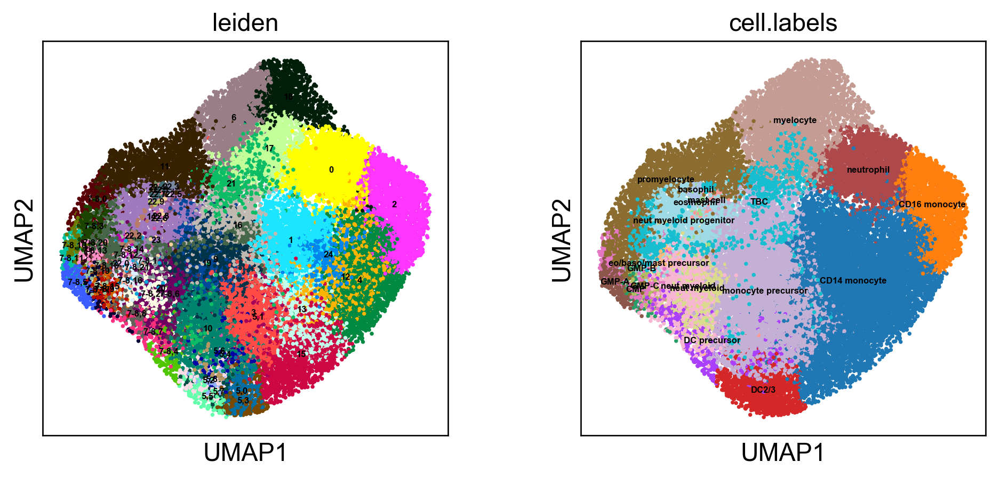

In [65]:
sc.pl.umap(adata, color=['leiden', 'cell.labels'], legend_loc="on data", size=20, legend_fontsize=5)

# Save the data

In [66]:
# save the adata with dr, leiden and degs saved 
adata.write('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221.h5ad')

/Users/b8058304/.pyenv/versions/3.6.4/envs/py36/lib/python3.6/site-packages/anndata/readwrite/write.py:316: UserWarning: Could not save field with key = 'uns/rank_genes_groups_filtered/names' to hdf5 file: invalid literal for int() with base 10: ''
  .format(key, e)


In [67]:
# save (again because of error) the adata with dr, leiden and degs saved 
adata.write('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221.h5ad')

In [68]:
cell_numbers = adata.obs.groupby(["cell.labels"]).apply(len)
cell_numbers

cell.labels
CD14 monocyte              8825
CD16 monocyte              2145
CMP                         100
DC2/3                      1215
DC precursor                603
GMP-A                       194
GMP-B                       436
GMP-C                       110
TBC                         989
basophil                    102
eo/baso/mast precursor       58
eosinophil                   65
mast cell                    60
monocyte precursor         7464
myelocyte                  3854
neut myeloid               1017
neut myeloid                790
neut myeloid progenitor    1571
neutrophil                 2371
promyelocyte               2498
dtype: int64

# Load the data again and reannotate

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import scipy.stats
import anndata
import matplotlib.pyplot as plt
import matplotlib as mpl

In [2]:
adata = sc.read('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 34467 × 33711 
    obs: 'AnnatomicalPart', 'LouvainClustering', '__is_in_cluster__', 'batch', 'cell.labels.backlabelled.1', 'cell.labels2', 'cell.labels_sb', 'doublets', 'fetal.ids', 'gender', 'is_doublet', 'is_doublet_poptrim', 'is_doublet_wolock', 'lanes', 'leiden', 'location', 'nGene', 'nUMI', 'n_genes', 'orig.ident', 'percent.mito', 'predicted.cell.label', 'processing.type', 'sample.type', 'scrublet_cluster_score', 'scrublet_score', 'sequencing.type', 'sort.ids', 'stages', 'tissue', 'cell.labels', 'orig_cell.labels'
    var: 'n_cells-0', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'gene_ids-1', 'feature_types-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'cell.labels2_colors', 'cell.labels_colors', 'dendrogram_leiden', 'diffmap_evals', 'draw_graph', 'leiden', 'leiden_colors', 'neighbors', 'orig.ident_colors', 'pca', 'rank_genes_groups', 'rank_genes_groups_filtered', 'sequencing.type_colors'

# Cluster DC cluster (5) slightly differently (more resolution) in order to pull out tDC, etc

In [9]:
clusters = ["5,0", "5,1", "5,2", "5,3", "5,4", "5,5", "5,6", "5,7", "5,8"]
categories = ["5", "5", "5", "5", "5", "5", "5", "5", "5"]

In [10]:
cell_numbers = adata.obs.groupby(["leiden"]).apply(len)
cell_numbers

leiden
0         2371
1         2229
2         2145
3         2126
4         1929
5,0        319
5,1        281
5,2        254
5,3        245
5,4        238
5,5        178
5,6        170
5,7        153
5,8         66
6         1840
7-8,0      260
7-8,1      254
7-8,2      233
7-8,3      217
7-8,4      201
7-8,5      194
7-8,6      188
7-8,7      170
7-8,8      164
7-8,9      153
7-8,10     144
7-8,11     143
7-8,12     140
7-8,13     140
7-8,14     123
          ... 
7-8,17     100
7-8,18      98
7-8,19      95
7-8,20      81
7-8,21      65
9         1612
10        1601
11        1561
12        1355
13        1353
14        1350
15        1329
16        1149
17        1069
18         945
19         806
20         790
21         537
22,0        58
22,1        52
22,2        50
22,3        41
22,4        39
22,5        37
22,6        34
22,7        31
22,8        23
22,9        11
23         361
24         349
Length: 62, dtype: int64

In [11]:
adata.obs["leiden"] = adata.obs["leiden"].replace(clusters, categories)

In [12]:
cell_numbers = adata.obs.groupby(["leiden"]).apply(len)
cell_numbers

leiden
0         2371
1         2229
10        1601
11        1561
12        1355
13        1353
14        1350
15        1329
16        1149
17        1069
18         945
19         806
2         2145
20         790
21         537
22,0        58
22,1        52
22,2        50
22,3        41
22,4        39
22,5        37
22,6        34
22,7        31
22,8        23
22,9        11
23         361
24         349
3         2126
4         1929
5         1904
6         1840
7-8,0      260
7-8,1      254
7-8,10     144
7-8,11     143
7-8,12     140
7-8,13     140
7-8,14     123
7-8,15     110
7-8,16     107
7-8,17     100
7-8,18      98
7-8,19      95
7-8,2      233
7-8,20      81
7-8,21      65
7-8,3      217
7-8,4      201
7-8,5      194
7-8,6      188
7-8,7      170
7-8,8      164
7-8,9      153
9         1612
dtype: int64

In [14]:
adata.obs["leiden"] = adata.obs["leiden"].astype("category")

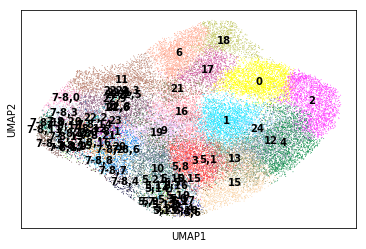

In [15]:
sc.tl.leiden(adata, resolution=2, random_state=26, n_iterations=-1, restrict_to=("leiden", ["5"]))
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=10, title="")

In [16]:
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
cell_numbers = adata.obs.groupby(["leiden", "cell.labels2"]).apply(len)
cell_numbers

leiden  cell.labels2           
0       CD14 monocyte               320
        CD16 monocyte               335
        DC3                           7
        basophil                      2
        mast cell                     1
        monocyte precursor           22
        monocytoid macrophage         5
        myelocyte                    40
        nan                         338
        neutrophil                 1292
        pDC                           1
        pDC precursor                 6
        stromal macrophage 2          2
1       CD14 monocyte              1426
        CD16 monocyte                74
        DC2                           1
        DC2/3                         4
        DC3                          34
        DC precursor                  3
        monocyte precursor          213
        monocytoid macrophage         7
        myelocyte                     6
        nan                         415
        neutrophil                   45
        

# Calculate differentially expressed genes for the DC subset

In [17]:
# run degs on normalised, logged and scaled data (saved as adata.X).
# calculate degs using wilcoxon rank sum test with benjamini-hochberg correction. 
#based on ln transformed count data 
sc.tl.rank_genes_groups(adata, groupby='leiden', method='wilcoxon', use_raw=False, log_transformed=True, groups = ['5,0', '5,1', '5,2', '5,3', '5,4', '5,5', '5,6', '5,7', '5,8', '5,9', '5,10', '5,11', '5,12', '5,13', '5,14', '5,15', '5,16', '5,17', '5,18', '5,19', '5,20', '5,21'])

In [18]:
# filter the degs for those which are expressed in at least 25% of cells in cluster. log2fc of the ln-transformed
# data will be shown.
sc.tl.filter_rank_genes_groups(adata, min_in_group_fraction=0.25, min_fold_change = 0.25, use_raw=False)

In [19]:
# save df for unfiltered degs
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
degs_by_cluster = pd.DataFrame({group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges']})

# the degs_by_cluster df shows the log2 fold change for each gene ordered by z-score underlying the computation 
# of a p-value for each gene for each group
degs_by_cluster.to_csv("/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/figs/clustering_degs/myeloid_dc_degs_by_cluster_20200221.csv")
degs_by_cluster[:10]

,"5,0_n","5,0_l","5,1_n","5,1_l","5,2_n","5,2_l","5,3_n","5,3_l","5,4_n","5,4_l","5,5_n","5,5_l","5,6_n","5,6_l","5,7_n","5,7_l","5,8_n","5,8_l","5,9_n","5,9_l","5,10_n","5,10_l","5,11_n","5,11_l","5,12_n","5,12_l","5,13_n","5,13_l","5,14_n","5,14_l","5,15_n","5,15_l","5,16_n","5,16_l","5,17_n","5,17_l","5,18_n","5,18_l","5,19_n","5,19_l","5,20_n","5,20_l","5,21_n","5,21_l"
0,CLEC10A,4.620738,S100A10,1.601046,HLA-DPA1,4.242979,HLA-DPA1,4.353588,CLEC10A,5.896234,MKI67,2.679785,HLA-DPA1,4.947552,HLA-DPA1,3.607665,HLA-DPA1,2.324691,CLEC10A,5.093097,HLA-DPA1,3.227168,HLA-DPA1,2.604034,HLA-DPA1,3.966433,HLA-DPA1,3.929100,HLA-DPA1,3.137126,KPNA2,3.639015,HLA-DPA1,2.457712,CLEC10A,5.715836,HLA-DPA1,4.272292,HLA-DPA1,3.267528,PPP1R14A,8.163868,HLA-DPA1,3.148514
1,HLA-DPA1,2.880354,HLA-DPA1,2.362911,CLEC10A,5.837894,HLA-DPB1,4.999252,HLA-DPA1,3.875784,CLEC10A,4.015316,HLA-DPB1,5.426043,C12orf75,4.506872,SAMHD1,1.593379,HLA-DPA1,3.231734,CLEC10A,4.903344,CD74,2.027174,BIN1,5.223906,CLEC10A,5.440320,GPR183,5.983011,CDC20,4.114780,HLA-DPB1,2.417395,HLA-DPA1,3.622907,HLA-DPB1,4.553967,CD74,2.465900,HLA-DPA1,3.766452,TMEM109,3.239077
2,HLA-DPB1,2.874736,CST3,1.283927,HLA-DPB1,4.240619,CLEC10A,5.934610,CD1C,7.119014,HLA-DPA1,2.229625,HLA-DRB1,3.340936,BIN1,5.369672,HLA-DRA,1.458373,C12orf75,4.005801,HLA-DRA,2.268795,MT-ND6,3.231559,PEBP1,3.387141,HLA-DPB1,4.143520,CLEC10A,4.685105,PTTG1,3.456405,CLEC10A,3.838734,HLA-DPB1,3.656855,HLA-DQA1,4.356559,HLA-DPB1,3.314480,HLA-DPB1,3.685583,C12orf75,3.511182
3,ABI3,2.814785,HLA-DRA,1.651665,HLA-DRB1,2.902379,HLA-DRA,3.048685,HLA-DPB1,3.982386,SMC4,2.501501,CD74,2.810871,S100B,6.736176,HLA-DRB1,1.775646,ENHO,7.897213,HLA-DPB1,3.416917,HLA-DPB1,2.582302,HLA-DPB1,3.792550,GPR183,5.329778,HLA-DPB1,3.164271,CCNB2,3.561722,HLA-DRA,1.467183,CD74,2.264503,HLA-DRB5,3.049377,HLA-DQA1,3.404238,CD7,5.210205,CLEC10A,4.784403
4,SAMHD1,1.746528,CLEC10A,3.830276,CD74,2.516397,HLA-DQA1,4.650805,CD74,2.163858,TOP2A,2.620152,HLA-DRA,3.139737,GPR183,5.197183,CD74,1.376275,DAB2,5.213680,HLA-DQA1,3.312607,MT-ATP8,1.957340,CD74,2.160295,ENHO,8.372128,HLA-DRA,1.968308,MS4A4A,4.063017,CD74,1.325167,HLA-DRA,2.138257,CLEC10A,5.135643,CLEC10A,4.249365,TMEM109,3.578985,NME1,3.309690
5,CD74,1.376273,KCTD12,1.755174,HLA-DRA,2.765608,HLA-DRB5,2.918798,HLA-DRB1,2.658717,CKS1B,2.703318,HLA-DMA,3.841033,HLA-DPB1,3.652991,CLEC10A,3.531686,HLA-DPB1,3.284106,ANXA2,1.837847,STMN1,2.081096,CLEC10A,4.747901,PPP1R14A,8.315464,C12orf75,3.738031,ANXA2,1.819189,SAMHD1,1.444277,HLA-DRB5,2.727618,CD74,2.522993,HLA-DRB1,2.184671,BIN1,5.045660,RANBP1,2.635197
6,GPR183,3.652155,SLC25A6,1.476157,HLA-DMA,3.419958,HLA-DMA,3.340744,ENHO,7.925570,HLA-DPB1,2.341707,HLA-DRB5,3.690805,PEBP1,3.321327,CD99,2.084319,CD1C,5.481255,CD74,1.471685,MT-ND4L,1.436900,ITGB7,4.690604,S100B,6.799849,HLA-DMA,2.490436,HMMR,4.105939,CES1,2.389405,HLA-DRB1,2.241788,BIN1,4.672065,SAMHD1,1.667018,HLA-DQA1,3.947644,FABP5,2.630109
7,C12orf75,2.562835,ANXA2,1.460052,HLA-DRB5,3.033033,HLA-DQA2,4.217854,ABI3,3.879015,NUSAP1,2.915650,HLA-DQA1,4.940473,TMEM109,3.841979,ANXA2,1.461572,GPR183,4.350172,HLA-DRB5,2.128064,HNRNPDL,1.422109,S100B,6.004254,C12orf75,3.755216,TGFBI,3.100495,CENPF,3.264471,HLA-DRB1,1.544916,PEBP1,2.631199,CIITA,5.084320,DAB2,4.183816,CD74,1.999621,HLA-DPB1,2.760139
8,CD1C,4.910852,MEF2C,1.927919,CD1C,6.744844,CD1C,6.510977,HLA-DRB5,3.125586,KCTD12,1.883119,HLA-DQB1,4.404339,LDHB,2.664392,HLA-DPB1,2.171010,STMN1,2.301808,ATP5O,2.376843,C12orf75,3.019704,HLA-DMA,3.228860,BIN1,4.856057,RHOC,5.133520,DLGAP5,3.390055,HLA-DRB5,1.652331,TMEM109,3.122096,HLA-DRB1,2.816284,SRSF2,2.144340,CLEC10A,4.429115,LDHB,1.971547
9,LMNB1,1.920664,CD74,1.064806,HLA-DQA1,3.994555,CD74,1.991955,HLA-DMA,3.083978,SMC2,2.664834,CLEC10A,5.695355,CLEC10A,4.669853,HLA-DRB5,1.958395,SAMHD1,2.015607,HLA-DMA,2.405487,RANBP1,1.939334,PEA15,4.428742,CD1C,6.524259,PSME2,2.538466,CCNA2,3.684807,LTBR,2.000600,HLA-DQA1,3.403704,HLA-DRA,2.710979,MT-ND6,3.013093,CIITA,4.391777,EEF1E1,3.244699


In [20]:
# save df for filtered degs
result = adata.uns['rank_genes_groups_filtered']
groups = result['names'].dtype.names
degs_by_cluster_filtered = pd.DataFrame({group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'logfoldchanges']})
# the degs_by_cluster df shows the log2 fold change for each gene ordered by z-score underlying the computation 
# of a p-value for each gene for each group
degs_by_cluster_filtered.to_csv("/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/figs/clustering_degs/myeloid_dc_degs_by_cluster_filtered_20200221.csv")
degs_by_cluster_filtered[:10]

,"5,0_n","5,0_l","5,1_n","5,1_l","5,2_n","5,2_l","5,3_n","5,3_l","5,4_n","5,4_l","5,5_n","5,5_l","5,6_n","5,6_l","5,7_n","5,7_l","5,8_n","5,8_l","5,9_n","5,9_l","5,10_n","5,10_l","5,11_n","5,11_l","5,12_n","5,12_l","5,13_n","5,13_l","5,14_n","5,14_l","5,15_n","5,15_l","5,16_n","5,16_l","5,17_n","5,17_l","5,18_n","5,18_l","5,19_n","5,19_l","5,20_n","5,20_l","5,21_n","5,21_l"
0,CLEC10A,4.620738,S100A10,1.601046,HLA-DPA1,4.242979,HLA-DPA1,4.353588,CLEC10A,5.896234,MKI67,2.679785,HLA-DPA1,4.947552,HLA-DPA1,3.607665,HLA-DPA1,2.324691,CLEC10A,5.093097,HLA-DPA1,3.227168,HLA-DPA1,2.604034,HLA-DPA1,3.966433,HLA-DPA1,3.929100,HLA-DPA1,3.137126,KPNA2,3.639015,HLA-DPA1,2.457712,CLEC10A,5.715836,HLA-DPA1,4.272292,HLA-DPA1,3.267528,PPP1R14A,8.163868,HLA-DPA1,3.148514
1,HLA-DPA1,2.880354,HLA-DPA1,2.362911,CLEC10A,5.837894,HLA-DPB1,4.999252,HLA-DPA1,3.875784,CLEC10A,4.015316,HLA-DPB1,5.426043,C12orf75,4.506872,SAMHD1,1.593379,HLA-DPA1,3.231734,CLEC10A,4.903344,CD74,2.027174,BIN1,5.223906,CLEC10A,5.440320,GPR183,5.983011,CDC20,4.114780,HLA-DPB1,2.417395,HLA-DPA1,3.622907,HLA-DPB1,4.553967,CD74,2.465900,HLA-DPA1,3.766452,TMEM109,3.239077
2,HLA-DPB1,2.874736,NaN,1.283927,HLA-DPB1,4.240619,CLEC10A,5.934610,CD1C,7.119014,HLA-DPA1,2.229625,HLA-DRB1,3.340936,BIN1,5.369672,HLA-DRA,1.458373,C12orf75,4.005801,HLA-DRA,2.268795,MT-ND6,3.231559,PEBP1,3.387141,HLA-DPB1,4.143520,CLEC10A,4.685105,PTTG1,3.456405,CLEC10A,3.838734,HLA-DPB1,3.656855,HLA-DQA1,4.356559,HLA-DPB1,3.314480,HLA-DPB1,3.685583,C12orf75,3.511182
3,ABI3,2.814785,HLA-DRA,1.651665,HLA-DRB1,2.902379,HLA-DRA,3.048685,HLA-DPB1,3.982386,SMC4,2.501501,CD74,2.810871,S100B,6.736176,HLA-DRB1,1.775646,ENHO,7.897213,HLA-DPB1,3.416917,HLA-DPB1,2.582302,HLA-DPB1,3.792550,GPR183,5.329778,HLA-DPB1,3.164271,CCNB2,3.561722,HLA-DRA,1.467183,CD74,2.264503,HLA-DRB5,3.049377,HLA-DQA1,3.404238,CD7,5.210205,CLEC10A,4.784403
4,SAMHD1,1.746528,CLEC10A,3.830276,CD74,2.516397,HLA-DQA1,4.650805,CD74,2.163858,TOP2A,2.620152,HLA-DRA,3.139737,GPR183,5.197183,CD74,1.376275,DAB2,5.213680,HLA-DQA1,3.312607,MT-ATP8,1.957340,CD74,2.160295,ENHO,8.372128,HLA-DRA,1.968308,MS4A4A,4.063017,CD74,1.325167,HLA-DRA,2.138257,CLEC10A,5.135643,CLEC10A,4.249365,TMEM109,3.578985,NME1,3.309690
5,CD74,1.376273,KCTD12,1.755174,HLA-DRA,2.765608,HLA-DRB5,2.918798,HLA-DRB1,2.658717,CKS1B,2.703318,HLA-DMA,3.841033,HLA-DPB1,3.652991,CLEC10A,3.531686,HLA-DPB1,3.284106,NaN,1.837847,STMN1,2.081096,CLEC10A,4.747901,PPP1R14A,8.315464,C12orf75,3.738031,NaN,1.819189,SAMHD1,1.444277,HLA-DRB5,2.727618,CD74,2.522993,HLA-DRB1,2.184671,BIN1,5.045660,RANBP1,2.635197
6,GPR183,3.652155,SLC25A6,1.476157,HLA-DMA,3.419958,HLA-DMA,3.340744,ENHO,7.925570,HLA-DPB1,2.341707,HLA-DRB5,3.690805,PEBP1,3.321327,CD99,2.084319,CD1C,5.481255,CD74,1.471685,MT-ND4L,1.436900,ITGB7,4.690604,S100B,6.799849,HLA-DMA,2.490436,HMMR,4.105939,CES1,2.389405,HLA-DRB1,2.241788,BIN1,4.672065,SAMHD1,1.667018,HLA-DQA1,3.947644,FABP5,2.630109
7,C12orf75,2.562835,ANXA2,1.460052,HLA-DRB5,3.033033,HLA-DQA2,4.217854,ABI3,3.879015,NUSAP1,2.915650,HLA-DQA1,4.940473,TMEM109,3.841979,NaN,1.461572,GPR183,4.350172,HLA-DRB5,2.128064,HNRNPDL,1.422109,S100B,6.004254,C12orf75,3.755216,TGFBI,3.100495,CENPF,3.264471,HLA-DRB1,1.544916,PEBP1,2.631199,CIITA,5.084320,DAB2,4.183816,CD74,1.999621,HLA-DPB1,2.760139
8,CD1C,4.910852,MEF2C,1.927919,CD1C,6.744844,CD1C,6.510977,HLA-DRB5,3.125586,KCTD12,1.883119,HLA-DQB1,4.404339,LDHB,2.664392,HLA-DPB1,2.171010,STMN1,2.301808,ATP5O,2.376843,C12orf75,3.019704,HLA-DMA,3.228860,BIN1,4.856057,RHOC,5.133520,DLGAP5,3.390055,HLA-DRB5,1.652331,TMEM109,3.122096,HLA-DRB1,2.816284,SRSF2,2.144340,CLEC10A,4.429115,LDHB,1.971547
9,LMNB1,1.920664,CD74,1.064806,HLA-DQA1,3.994555,CD74,1.991955,HLA-DMA,3.083978,SMC2,2.664834,CLEC10A,5.695355,CLEC10A,4.669853,HLA-DRB5,1.958395,SAMHD1,2.015607,HLA-DMA,2.405487,RANBP1,1.939334,PEA15,4.428742,CD1C,6.524259,PSME2,2.538466,CCNA2,3.684807,LTBR,2.000600,HLA-DQA1,3.403704,HLA-DRA,2.710979,MT-ND6,3.013093,CIITA,4.391777,EEF1E1,3.244699


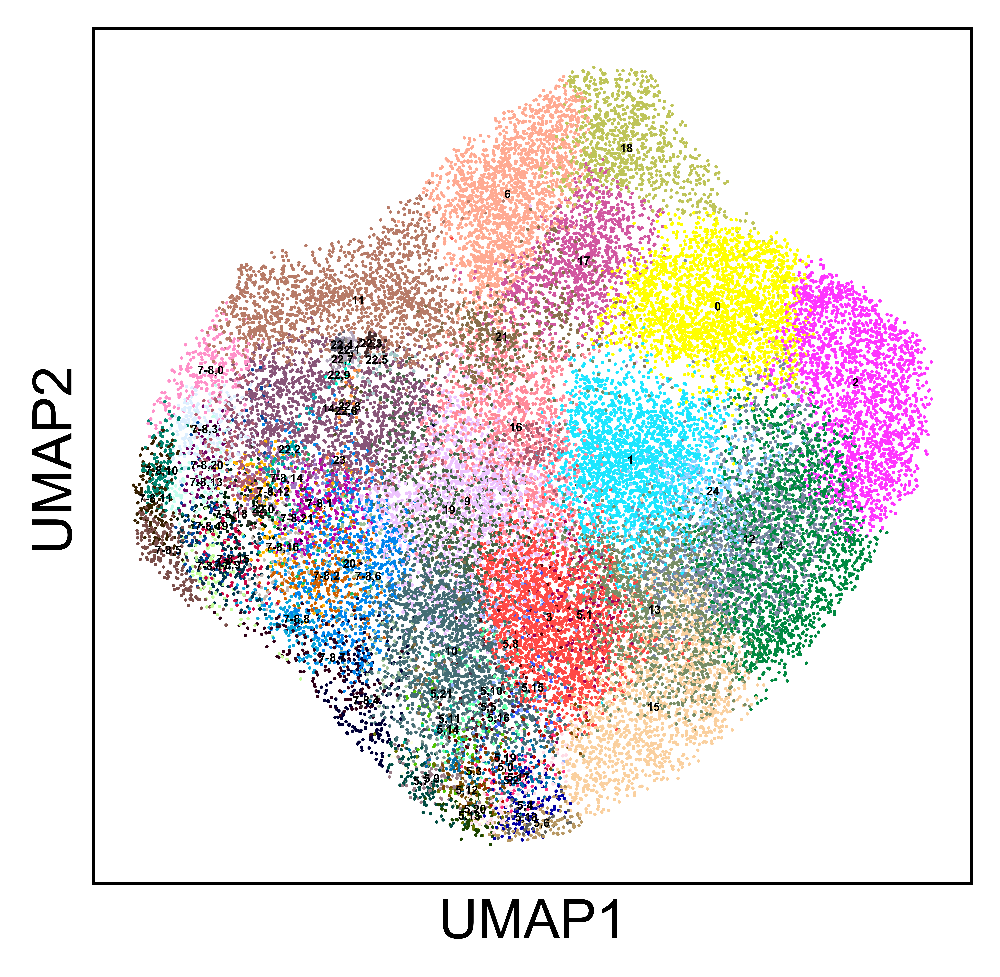

In [22]:
sc.settings.set_figure_params(dpi=1000, dpi_save=1000)
sc.pl.umap(adata, color='leiden', legend_loc="on data", size=3, legend_fontsize=3, title="")

In [23]:
cell_numbers = adata.obs.groupby(["leiden"]).apply(len)
cell_numbers

leiden
0         2371
1         2229
2         2145
3         2126
4         1929
5,0        159
5,1        153
5,2        129
5,3        128
5,4        121
5,5        118
5,6        107
5,7        104
5,8         94
5,9         88
5,10        86
5,11        83
5,12        75
5,13        64
5,14        62
5,15        62
5,16        56
5,17        52
5,18        44
5,19        43
5,20        38
5,21        38
6         1840
7-8,0      260
7-8,1      254
7-8,2      233
7-8,3      217
7-8,4      201
7-8,5      194
7-8,6      188
7-8,7      170
7-8,8      164
7-8,9      153
7-8,10     144
7-8,11     143
7-8,12     140
7-8,13     140
7-8,14     123
7-8,15     110
7-8,16     107
7-8,17     100
7-8,18      98
7-8,19      95
7-8,20      81
7-8,21      65
9         1612
10        1601
11        1561
12        1355
13        1353
14        1350
15        1329
16        1149
17        1069
18         945
19         806
20         790
21         537
22,0        58
22,1        52
22,2        50
22,

In [24]:
# save the adata with dr, leiden and degs saved 
adata.write('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221.h5ad')

/Users/b8058304/.pyenv/versions/3.6.4/envs/py36/lib/python3.6/site-packages/anndata/readwrite/write.py:316: UserWarning: Could not save field with key = 'uns/rank_genes_groups_filtered/names' to hdf5 file: invalid literal for int() with base 10: ''
  .format(key, e)


In [25]:
# save (again because of error) the adata with dr, leiden and degs saved 
adata.write('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221.h5ad')

# Load the data again and reannotate

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import scipy.stats
import anndata
import matplotlib.pyplot as plt
import matplotlib as mpl

In [ ]:
adata = sc.read('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221.h5ad')

In [ ]:
adata

# Add in annotations

In [ ]:
# read in annotation.csv which contains: 'Cluster' column for leiden clusters and 'Category' column for annotations
annotation = pd.read_csv("/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/resources_for_pipelines/bm_plus_19pcw_myeloid_annot_20200221LJ.csv", index_col=False)

In [ ]:
# convert the clusters column to a string (so that it can be input into the replace function, which acts on strings)
annotation.Cluster = annotation.Cluster.apply(str)
# make a temp metadata column for new cell labels from the leiden clusters
adata.obs["new.cell.labels"] = adata.obs["leiden"]
# have a look at new.cell.labels metadata column before mapping
adata.obs["new.cell.labels"][:15]

In [ ]:
# save the clusters/categories columns as named lists 
clusters = annotation["Cluster"].tolist()
categories = annotation["Category"].tolist()
# replace all values in new.cell.labels column matchin clusters values with categories values
adata.obs["new.cell.labels"] = adata.obs["new.cell.labels"].replace(clusters, categories)

In [ ]:
# have a look at new.cell.labels metadata column after mapping
adata.obs["new.cell.labels"][:15]

In [ ]:
# save the current cell.labels as cell.labels.backlabelled.1 and save the temp new.cell.labels which we have just 
# created, containing new cell.labels as cell.labels 
adata.obs["cell.labels"] = adata.obs["new.cell.labels"]
del adata.obs["new.cell.labels"] 

In [ ]:
sc.pl.umap(adata, color=['leiden', 'cell.labels'], legend_loc="on data", size=20, legend_fontsize=5)

# Save the data

In [ ]:
# save the adata with dr, leiden and degs saved 
adata.write('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221b.h5ad')

In [ ]:
# save the adata with dr and leiden saved at resolution 1
adata.write('/Users/b8058304/Documents/PhD_work/Coding/bm_plus_19pcw/data/subset_myeloid/bm_plus_19pcw_myeloid_annot_20200221b.h5ad')